# Data Exploration / Cleaning

## 1. Load Dataset

In [1]:
import pandas as pd

# Load the dataset
train_df = pd.read_csv(r'C:\Users\H.P\Desktop\Housing Regression MLE\data\raw\train.csv')
eval_df = pd.read_csv(r'C:\Users\H.P\Desktop\Housing Regression MLE\data\raw\eval.csv')
metro = pd.read_csv(r'C:\Users\H.P\Desktop\Housing Regression MLE\data\raw\usmetros.csv')

pd.set_option('display.max_columns', None)  # to display all columns when printing dataframes
pd.set_option('display.max_rows', None)     # to display all rows when printing dataframes

In [2]:
print(train_df.shape)
print(eval_df.shape)

(585244, 39)
(149424, 39)


In [3]:
train_df['city_full'].value_counts().size

30

In [4]:
train_df['city_full'].value_counts().head() 

city_full
New York-Newark-Jersey City       78020
Chicago-Naperville-Elgin          35344
Los Angeles-Long Beach-Anaheim    33840
Philadelphia-Camden-Wilmington    31396
DC_Metro                          29516
Name: count, dtype: int64

So we have 30 cities, now we have to convert them to numerical in order to apply ML on it. But here we can't just simply convert them into nominal i.e. assign number to each city as that will create bias in the model. As higher number will be more prefered which shouldn't be the case. And One hot encoding will create a lot of columns making the model slow increasing our pain

### Map cities to Lat/Long
- The goal is to use Lattitude and longitude instead of cities for our ML models

In [5]:
metro.head(2)

,metro_fips,metro,metro_ascii,metro_full,county_name,county_fips,state_id,state_name,lat,lng,population
0,35620,New York,New York,New York-Newark-Jersey City,Suffolk,36103,NY,New York,40.7222,-74.0225,19498249
1,31080,Los Angeles,Los Angeles,Los Angeles-Long Beach-Anaheim,Los Angeles,6037,CA,California,34.2215,-118.1494,12799100


In [6]:
metro['metro_full'].value_counts().size

370

## 2. Fixing city names mismatch

In [7]:
invalid = []
for city in train_df['city_full'].unique():
    if city not in metro['metro_full'].values:
        invalid.append(city)
        print(city)
print(f'Total invalid cities: {len(invalid)}')

Atlanta-Sandy Springs-Alpharetta
San Francisco-Oakland-Berkeley
Austin-Round Rock-Georgetown
Houston-The Woodlands-Sugar Land
Denver-Aurora-Lakewood
DC_Metro
Las Vegas-Henderson-Paradise
Miami-Fort Lauderdale-Pompano Beach
Total invalid cities: 8


So our plan to convert the names to lattitude and longitude, comes into problem for this 8. As they will give us problem, so we have to explicitly resolve them

In [8]:
set(invalid[0].split('-'))

{'Alpharetta', 'Atlanta', 'Sandy Springs'}

In [9]:
matches_dict = {}
for city in invalid:
    city_words = set(city.split('-'))  # Split by dash or adjust to your delimiter
    best_matches = []
    for match in metro['metro_full'].values:
        match_words = set(match.split('-'))
        if city_words & match_words:  # If any word overlaps
            best_matches.append(match)
    matches_dict[city] = best_matches

matches_dict


{'Atlanta-Sandy Springs-Alpharetta': ['Atlanta-Sandy Springs-Roswell'],
 'San Francisco-Oakland-Berkeley': ['San Francisco-Oakland-Fremont'],
 'Austin-Round Rock-Georgetown': ['Austin-Round Rock-San Marcos'],
 'Houston-The Woodlands-Sugar Land': ['Houston-Pasadena-The Woodlands'],
 'Denver-Aurora-Lakewood': ['Denver-Aurora-Centennial'],
 'DC_Metro': [],
 'Las Vegas-Henderson-Paradise': ['Las Vegas-Henderson-North Las Vegas'],
 'Miami-Fort Lauderdale-Pompano Beach': ['Miami-Fort Lauderdale-West Palm Beach']}

for DC_Metro -> it is completely diffn from metro dataset, it is 'Washington-Arlington-Alexandria' 
This could be done due to only domain knowledge, not coding or anything. Or the only other option I could think is to drop it

In [10]:
# Fixing city names
city_mapping = {
    'Las Vegas-Henderson-Paradise': 'Las Vegas-Henderson-North Las Vegas',
    'Denver-Aurora-Lakewood': 'Denver-Aurora-Centennial',
    'Houston-The Woodlands-Sugar Land': 'Houston-Pasadena-The Woodlands',
    'Austin-Round Rock-Georgetown': 'Austin-Round Rock-San Marcos',
    'Miami-Fort Lauderdale-Pompano Beach': 'Miami-Fort Lauderdale-West Palm Beach',
    'San Francisco-Oakland-Berkeley': 'San Francisco-Oakland-Fremont',
    'DC_Metro': 'Washington-Arlington-Alexandria',
    'Atlanta-Sandy Springs-Alpharetta': 'Atlanta-Sandy Springs-Roswell'
}

In [11]:
train_df.merge(
    metro[["metro_full", "lat", "lng"]],
    how='left',
    left_on='city_full',
    right_on='metro_full'
).head(2)

,date,median_sale_price,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,city,zipcode,year,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,city_full,metro_full,lat,lng
0,2012-03-31,46550.0,217450.0,31.813674,110.183666,14.0,23.0,44.0,64.0,59.5,0.943662,0.142857,0.043478,ATL,30002,2012,12.0,2.0,4.0,1.0,60.0,45.0,57.0,4.0,7.0,5811.0,36.3,33052.0,5811.0,2677.0,710.0,279500.0,3171.0,460.0,5408.0,5408.0,2492.0,200773.999557,Atlanta-Sandy Springs-Alpharetta,NaN,NaN,NaN
1,2012-03-31,200000.0,7500.0,104.931794,79.265873,1.0,1.0,1.0,2.0,290.0,0.909091,0.000000,0.000000,PGH,15469,2012,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,2441.0,41.8,20241.0,2385.0,1108.0,641.0,94600.0,1171.0,52.0,2376.0,2376.0,1018.0,105863.681174,Pittsburgh,Pittsburgh,40.4744,-79.8632


In [12]:
# so now we have to -> replace -> merge -> catch any null/missing 
def clean_and_merge(df: pd.DataFrame) -> pd.DataFrame:
    """Apply city name fixes, merge lat/lng from metros, drop dup col."""

    # Apply city name fixes
    df['city_full'] = df['city_full'].replace(city_mapping)

    # Merge lat/lng from metros
    df = df.merge(
        metro[["metro_full", "lat", "lng"]],
        how='left',
        left_on='city_full',
        right_on='metro_full'
    )
    # Drop duplicate metro_full column
    df = df.drop(columns=['metro_full'])

    #log any cities that still miss any values
    missing = df[df['lat'].isnull()]['city_full'].unique()
    if len(missing) > 0:
        print(f"Cities with missing lat/lng after merge: {missing}")
    else:
        print("All cities successfully merged with lat/lng.")

    return df

## 3. Apply cleaning + merge to both train and eval

In [13]:
# 3. Apply cleaning + merge to both train and eval
train_df = clean_and_merge(train_df)
eval_df = clean_and_merge(eval_df)

All cities successfully merged with lat/lng.
All cities successfully merged with lat/lng.


In [14]:
print(train_df.shape)
print(eval_df.shape)

(585244, 41)
(149424, 41)


In [15]:
train_df.head(3)

,date,median_sale_price,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,city,zipcode,year,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,city_full,lat,lng
0,2012-03-31,46550.0,217450.0,31.813674,110.183666,14.0,23.0,44.0,64.0,59.5,0.943662,0.142857,0.043478,ATL,30002,2012,12.0,2.0,4.0,1.0,60.0,45.0,57.0,4.0,7.0,5811.0,36.3,33052.0,5811.0,2677.0,710.0,279500.0,3171.0,460.0,5408.0,5408.0,2492.0,200773.999557,Atlanta-Sandy Springs-Roswell,33.7338,-84.3922
1,2012-03-31,200000.0,7500.0,104.931794,79.265873,1.0,1.0,1.0,2.0,290.0,0.909091,0.000000,0.000000,PGH,15469,2012,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,2441.0,41.8,20241.0,2385.0,1108.0,641.0,94600.0,1171.0,52.0,2376.0,2376.0,1018.0,105863.681174,Pittsburgh,40.4744,-79.8632
2,2012-03-31,75750.0,92400.0,165.898618,63.412698,2.0,2.0,4.0,13.0,193.0,0.986815,0.000000,0.000000,PGH,15468,2012,0.0,0.0,0.0,0.0,1.0,0.0,5.0,0.0,0.0,2171.0,47.8,18740.0,2094.0,1252.0,627.0,62800.0,894.0,30.0,2106.0,2106.0,807.0,60152.096646,Pittsburgh,40.4744,-79.8632


## 4. Check for duplicates and clean them up

In [16]:
train_df.shape

(585244, 41)

In [17]:
train_df[train_df.duplicated()].shape[0]  # number of duplicate rows

0

In house price data, many properties can have sales records for multiple different dates/years, but the other features (location, bedrooms, etc.) may be identical.

In [18]:
train_df[train_df.duplicated(subset=train_df.columns.difference(['date','year']))].shape[0]

6321

In [19]:
print(train_df.shape)


duplicated_rows = train_df[train_df.duplicated()].shape[0]
print("duplicated_rows:", duplicated_rows)

duplicated_rows = train_df[train_df.duplicated(subset=train_df.columns.difference(['date', 'year']))].shape[0]
print("duplicated_rows excluding date column:", duplicated_rows)

(585244, 41)
duplicated_rows: 0
duplicated_rows excluding date column: 6321


In [20]:
#delete duplicates
train_df = train_df.drop_duplicates(subset=train_df.columns.difference(['date','year']))
print(train_df.shape)

duplicated_rows = train_df[train_df.duplicated()].shape[0]
print("duplicated_rows:", duplicated_rows)

duplicated_rows = train_df[train_df.duplicated(subset=train_df.columns.difference(['date', 'year']))].shape[0]
print("duplicated_rows excluding date column:", duplicated_rows)

(578923, 41)
duplicated_rows: 0
duplicated_rows excluding date column: 0


same for eval set

In [21]:
print(eval_df.shape)

duplicated_rows = eval_df[eval_df.duplicated()].shape[0]
print("duplicated_rows:", duplicated_rows)

duplicated_rows = eval_df[eval_df.duplicated(subset=eval_df.columns.difference(['date', 'year']))].shape[0]
print("duplicated_rows excluding date column:", duplicated_rows)

(149424, 41)
duplicated_rows: 0
duplicated_rows excluding date column: 726


In [22]:
# Delete duplicates
eval_df = eval_df.drop_duplicates(subset=eval_df.columns.difference(['date', 'year']), keep=False)

print(eval_df.shape)


duplicated_rows = eval_df[eval_df.duplicated()].shape[0]
print("duplicated_rows:", duplicated_rows)

duplicated_rows = eval_df[eval_df.duplicated(subset=eval_df.columns.difference(['date', 'year']))].shape[0]
print("duplicated_rows excluding date column:", duplicated_rows)

(148449, 41)
duplicated_rows: 0
duplicated_rows excluding date column: 0


### Cleaning Outliers

In [23]:
train_df['median_list_price'].describe()

count    5.789230e+05
mean     3.729765e+05
std      2.314906e+06
min      0.000000e+00
25%      1.720000e+05
50%      2.750000e+05
75%      4.390000e+05
max      1.000000e+09
Name: median_list_price, dtype: float64

In [24]:
import plotly.express as px

fig = px.violin(train_df, y='median_list_price', box=True, hover_name='median_list_price')
fig.update_layout(title='Violin Plot of Median List Price')
fig.show()

In [26]:
top_1_percent = train_df.nlargest(int(0.01 * len(train_df)), 'median_list_price')
print(top_1_percent.shape)
top_1_percent.head()

(5789, 41)


,date,median_sale_price,median_list_price,median_ppsf,median_list_ppsf,homes_sold,pending_sales,new_listings,inventory,median_dom,avg_sale_to_list,sold_above_list,off_market_in_two_weeks,city,zipcode,year,bank,bus,hospital,mall,park,restaurant,school,station,supermarket,Total Population,Median Age,Per Capita Income,Total Families Below Poverty,Total Housing Units,Median Rent,Median Home Value,Total Labor Force,Unemployed Population,Total School Age Population,Total School Enrollment,Median Commute Time,price,city_full,lat,lng
271684,2015-10-31,439000.0,999999999.0,218.867925,236.391156,243.0,269.0,671.0,259.0,46.0,0.980975,0.160494,0.130112,DC,20878,2015,9.0,0.0,4.0,1.0,110.0,59.0,50.0,2.0,11.0,63855.0,38.1,52955.0,63757.0,23514.0,1677.0,535500.0,36595.0,1960.0,61237.0,61237.0,32125.0,514388.985999,Washington-Arlington-Alexandria,38.8446,-77.5092
275824,2015-11-30,425000.0,999999999.0,220.055710,236.634569,241.0,284.0,616.0,196.0,47.0,0.979123,0.132780,0.133803,DC,20878,2015,9.0,0.0,4.0,1.0,110.0,59.0,50.0,2.0,11.0,63855.0,38.1,52955.0,63757.0,23514.0,1677.0,535500.0,36595.0,1960.0,61237.0,61237.0,32125.0,514884.401131,Washington-Arlington-Alexandria,38.8446,-77.5092
283729,2015-12-31,439444.0,999999999.0,217.479377,231.798505,254.0,255.0,536.0,136.0,53.0,0.976354,0.137795,0.109804,DC,20878,2015,9.0,0.0,4.0,1.0,110.0,59.0,50.0,2.0,11.0,63855.0,38.1,52955.0,63757.0,23514.0,1677.0,535500.0,36595.0,1960.0,61237.0,61237.0,32125.0,515206.049773,Washington-Arlington-Alexandria,38.8446,-77.5092
312332,2016-05-31,270000.0,50449949.5,232.758621,4156.568441,1.0,1.0,2.0,2.0,264.0,1.000000,0.000000,0.000000,DC,20838,2016,0.0,0.0,0.0,0.0,11.0,1.0,4.0,2.0,0.0,247.0,49.6,61165.0,243.0,93.0,1507.0,607100.0,135.0,0.0,239.0,239.0,122.0,673997.281067,Washington-Arlington-Alexandria,38.8446,-77.5092
323492,2016-06-30,415000.0,50449949.5,257.508343,4156.568441,2.0,2.0,2.0,2.0,324.5,1.000447,0.500000,0.000000,DC,20838,2016,0.0,0.0,0.0,0.0,11.0,1.0,4.0,2.0,0.0,247.0,49.6,61165.0,243.0,93.0,1507.0,607100.0,135.0,0.0,239.0,239.0,122.0,673997.281067,Washington-Arlington-Alexandria,38.8446,-77.5092


In [27]:
top_1_percent = train_df.nlargest(int(0.01 * len(train_df)), 'median_list_price')
print(top_1_percent['median_list_price'].value_counts().sort_index(ascending=False))

median_list_price
999999999.0      3
50449949.5       3
27800000.0       1
19990000.0      38
15849000.0       1
15624500.0       3
15500000.0       1
13995000.0       1
13100000.0       2
12772000.0       1
12500000.0       5
11900000.0       1
11495000.0       1
10747500.0       1
10692000.0      16
10000000.0       3
9999998.0        1
9934000.0        2
9697500.0        3
9547500.0        1
9394000.0        1
9350000.0        1
9100000.0        1
8900000.0        1
8793944.0        5
8750000.0        3
8700000.0        2
8500000.0        1
8495000.0        1
8142500.0        1
8000000.0        3
7995000.0        1
7988000.0        1
7947500.0        1
7941500.0        1
7750000.0        4
7695000.0        2
7522500.0        1
7495000.0        1
7472500.0        1
7450000.0        1
7442500.0        2
7424000.0        1
7374950.0        1
7300000.0        3
7299500.0        1
7245000.0        1
7199000.0        3
7000000.0        1
6999500.0        1
6995000.0       31
6945000.0    

- Investigate if median_list_price outliers are independent in distinct regions (for example if DC has different median_list_price)
- Drop outliers to keep things realistic and clean

In [28]:
# Clean outliers above 20M in both train and eval -> This is a complete random number based on requirements,
# but currently as this is a project so I am taking 20M as threshold
train_df = train_df[train_df['median_list_price'] <= 20_000_000].copy()
eval_df = eval_df[eval_df['median_list_price'] <= 20_000_000].copy()

In [29]:
import plotly.express as px

fig = px.violin(train_df, y="median_list_price", box=True, hover_name="median_list_price")
fig.update_layout(title="Violin Plot of Median List Price")
fig.show()

In [30]:
top_1_percent = train_df.nlargest(int(0.01 * len(train_df)), 'median_list_price')
print(top_1_percent['median_list_price'].value_counts().sort_index(ascending=False))

median_list_price
19990000.0     38
15849000.0      1
15624500.0      3
15500000.0      1
13995000.0      1
13100000.0      2
12772000.0      1
12500000.0      5
11900000.0      1
11495000.0      1
10747500.0      1
10692000.0     16
10000000.0      3
9999998.0       1
9934000.0       2
9697500.0       3
9547500.0       1
9394000.0       1
9350000.0       1
9100000.0       1
8900000.0       1
8793944.0       5
8750000.0       3
8700000.0       2
8500000.0       1
8495000.0       1
8142500.0       1
8000000.0       3
7995000.0       1
7988000.0       1
7947500.0       1
7941500.0       1
7750000.0       4
7695000.0       2
7522500.0       1
7495000.0       1
7472500.0       1
7450000.0       1
7442500.0       2
7424000.0       1
7374950.0       1
7300000.0       3
7299500.0       1
7245000.0       1
7199000.0       3
7000000.0       1
6999500.0       1
6995000.0      31
6945000.0       1
6847500.0       1
6844000.0       2
6822000.0       1
6720000.0       1
6700000.0       1
6665000.0 

## 4. Save Cleaned datasets

In [31]:
# save cleaned datasets
train_df.to_csv(r'C:\Users\H.P\Desktop\Housing Regression MLE\data\processed\train_cleaned.csv', index=False)
eval_df.to_csv(r'C:\Users\H.P\Desktop\Housing Regression MLE\data\processed\eval_cleaned.csv', index=False)
print("Cleaned datasets saved successfully.")

Cleaned datasets saved successfully.


# House Prices Exploration

In [32]:
df = train_df

In [37]:
top_cities = df["city"].value_counts().head(30).index.tolist() # Gets the 30 cities with the most entries in data.
df_city    = df[df["city"].isin(top_cities)] # Filters the main DataFrame df to only rows from these cities.
df_city.groupby("city")["price"].median().sort_values(ascending=False)

city
SF     821356.448410
LA     535989.296133
SD     487012.538033
NY     433135.566392
BOS    393878.773801
DC     366950.657588
SEA    351377.972354
SAC    343265.191452
BWI    326084.434031
PDX    316974.194083
DEN    313644.672130
ATX    257671.159788
RIV    249788.868976
MIA    240867.295052
PHL    232859.990998
MSP    228247.511487
PHX    220808.163372
LV     214835.785911
CHI    194820.172991
ORL    186930.502650
DAL    181900.752088
SA     176017.700751
TPA    175075.944984
HOU    172383.158897
ATL    167109.067053
DET    159322.832672
CLT    156813.826986
STL    145557.952735
CIN    138142.081431
PGH    114866.775213
Name: price, dtype: float64

Matplotlib is building the font cache; this may take a moment.
C:\Users\H.P\AppData\Local\Temp\ipykernel_14716\1245003355.py:36: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.




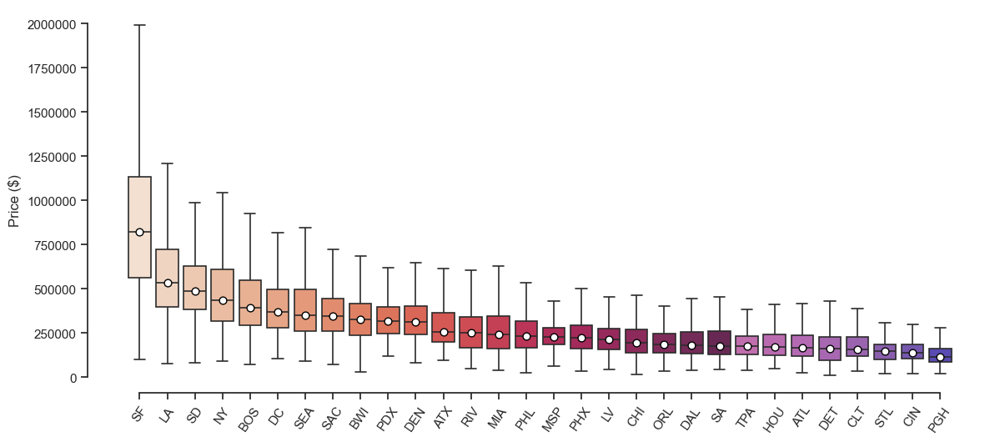

In [38]:
# (This code/stuff is not from me, I am not great at visualizations, just found it online and modified a bit)
import seaborn as sns
import matplotlib.pyplot as plt
import colorsys
sns.set_theme(style="whitegrid")           

# Boxplot of house prices for the cities, ordered by median price.

top_cities = df["city"].value_counts().head(30).index.tolist() # Gets the 30 cities with the most entries in data.
df_city    = df[df["city"].isin(top_cities)] # Filters the main DataFrame df to only rows from these cities.
city_order = (
    df_city.groupby("city")["price"] # Groups the filtered DataFrame by city and calculates the median price for each city.
           .median() 
           .sort_values(ascending=False) # Sorts the cities by median price in descending order.
           .index # Gets the ordered list of city names.
) # Order Cities by Median House Price

# --- Just Build Color Palette, Lightening Last 8 Most Expensive Cities --- => Prettifying ----------------

base = sns.color_palette("rocket_r", len(city_order)) # using rocket_r palette for as many colors as cities

def lighten(color, amt=.4): # Lightens a given RGB color by converting it to HLS and raising its lightness.
    h, l, s = colorsys.rgb_to_hls(*color)
    return colorsys.hls_to_rgb(h, min(1, l + amt*(1-l)), s)

palette = [
    lighten(c, .45) if i >= len(base) - 8 else c
    for i, c in enumerate(base)
] # For the last 8 cities (bottom of the sorted list), lightens their colors for a subtle highlight.

# ----------------------------------------------------------------------------------------------------------

sns.set_theme(style="ticks") # Sets a different theme ("ticks").
fig, ax = plt.subplots(figsize=(14, 6)) # Creates the plot figure and axis, setting a wide layout.

sns.boxplot(
    x="city", y="price", data=df_city,
    order=city_order, palette=palette,
    showfliers=False, linewidth=1.2, ax=ax
) # Boxplot of house prices by city, ordered by median price, with custom palette.

# Mark City Medians with White Dots
medians = df_city.groupby("city")["price"].median().loc[city_order]
for tick, median in enumerate(medians):
    ax.scatter(tick, median, color="white", edgecolor="black", zorder=5, s=40)

# Polish Axes and Style
ax.set_xlabel("")
ax.set_ylabel("Price ($)")
ax.tick_params(axis="x", rotation=55)
sns.despine(trim=True)
ax.grid(False)
ax.ticklabel_format(axis="y", style="plain")

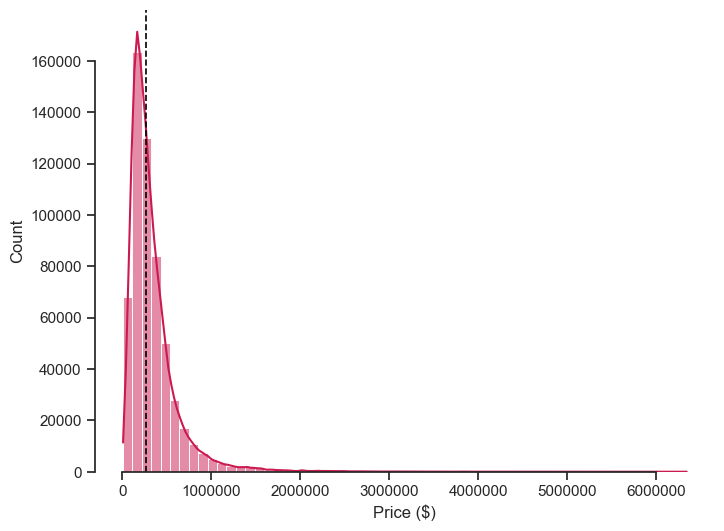

In [ ]:
# Distribution of house prices across the dataset 

# Setting up the plot
sns.set_theme(style="ticks")
fig, ax = plt.subplots(figsize=(8, 6)) 

# Histogram with KDE of house prices
sns.histplot(df["price"].dropna(), bins=60, kde=True, color=sns.color_palette("rocket_r", 1)[0], ax=ax)

# Mark Median Price with Dashed Line
median_price = df["price"].median()
ax.axvline(median_price, ls="--", lw=1.2, color="black")

# Polish Axes and Style
ax.set_xlabel("Price ($)")
ax.set_ylabel("Count")
sns.despine(trim=True)
ax.grid(False)
ax.ticklabel_format(axis="x", style="plain")
plt.show()